<a href="https://colab.research.google.com/github/fin-ash/MAIR/blob/main/Autoencoder%20-%20RNDL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import numpy as np
import os
from google.colab import drive
import zipfile
from tqdm import tqdm
import cv2
import matplotlib.pyplot as plt

# Mount Google Drive
drive.mount('/content/drive')

# Define parameters
IMG_SIZE = 64
NUM_SAMPLES = 4000  # Adjust as needed
NOISE_TYPES = ['gaussian', 'salt_and_pepper', 'poisson', 'speckle']
NOISE_FACTORS = [0.1, 0.3, 0.5]  # Different noise intensities

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
def download_and_extract_dataset():
    url = "https://download.microsoft.com/download/3/E/1/3E1C3F21-ECDB-4869-8368-6DEBA77B919F/kagglecatsanddogs_5340.zip"
    filename = "kagglecatsanddogs_5340.zip"

        # Download the file
    !wget -O {filename} {url}

    # Extract the contents
    with zipfile.ZipFile(filename, 'r') as zip_ref:
        zip_ref.extractall('dataset')

In [3]:
def load_and_preprocess_data(data_dir, img_size, num_samples):
    images = []
    for category in ['Dog']:
        path = os.path.join(data_dir, category)
        files = os.listdir(path)
        for file in tqdm(files, desc=f"Loading {category} images"):
            if len(images) >= num_samples:
                break
            img_path = os.path.join(path, file)
            try:
                img = cv2.imread(img_path)
                if img is None:
                    print(f"Skipping {img_path}: Unable to read image")
                    continue
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, (img_size, img_size))
                images.append(img)
            except Exception as e:
                print(f"Error processing {img_path}: {str(e)}")

    return np.array(images) / 255.0

def add_noise(image, noise_type, noise_factor):
    if noise_type == 'gaussian':
        row, col, ch = image.shape
        mean = 0
        sigma = noise_factor
        gauss = np.random.normal(mean, sigma, (row, col, ch))
        noisy = image + gauss
        return np.clip(noisy, 0, 1)
    elif noise_type == 'salt_and_pepper':
        row, col, ch = image.shape
        s_vs_p = 0.5
        amount = noise_factor
        out = np.copy(image)
        # Salt mode
        num_salt = np.ceil(amount * image.size * s_vs_p)
        coords = [np.random.randint(0, i - 1, int(num_salt))
                  for i in image.shape]
        out[coords] = 1
        # Pepper mode
        num_pepper = np.ceil(amount * image.size * (1. - s_vs_p))
        coords = [np.random.randint(0, i - 1, int(num_pepper))
                  for i in image.shape]
        out[coords] = 0
        return out
    elif noise_type == 'poisson':
        vals = len(np.unique(image))
        vals = 2 ** np.ceil(np.log2(vals))
        noisy = np.random.poisson(image * vals) / float(vals)
        return np.clip(noisy, 0, 1)
    elif noise_type == 'speckle':
        row, col, ch = image.shape
        gauss = np.random.randn(row, col, ch)
        gauss = gauss.reshape(row, col, ch)
        noisy = image + image * gauss * noise_factor
        return np.clip(noisy, 0, 1)
    else:
        return image

def create_noisy_dataset(images):
    noisy_datasets = {}
    for noise_type in NOISE_TYPES:
        for noise_factor in NOISE_FACTORS:
            key = f"{noise_type}_{noise_factor}"
            noisy_images = np.array([add_noise(img, noise_type, noise_factor) for img in tqdm(images, desc=f"Adding {noise_type} noise (factor: {noise_factor})")])
            noisy_datasets[key] = noisy_images
    return noisy_datasets

def save_dataset(original_images, noisy_datasets, save_dir):
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    np.save(os.path.join(save_dir, 'original_images.npy'), original_images)

    for key, noisy_images in noisy_datasets.items():
        np.save(os.path.join(save_dir, f'noisy_images_{key}.npy'), noisy_images)

def plot_noisy_images(original_images, noisy_datasets, num_images=5):
    num_images = min(num_images, len(original_images))
    fig, axes = plt.subplots(len(NOISE_TYPES) + 1, len(NOISE_FACTORS) + 1, figsize=(20, 20))
    fig.suptitle("Original Images vs Noisy Images", fontsize=16)

# Main execution
if __name__ == "__main__":
    download_and_extract_dataset()
    data_dir = 'dataset/PetImages'
    images = load_and_preprocess_data(data_dir, IMG_SIZE, NUM_SAMPLES)
    noisy_datasets = create_noisy_dataset(images)
    save_dir = '/content/drive/MyDrive/noisy_dataset'
    save_dataset(images, noisy_datasets, save_dir)

    print("Dataset created!")

--2024-07-10 14:25:29--  https://download.microsoft.com/download/3/E/1/3E1C3F21-ECDB-4869-8368-6DEBA77B919F/kagglecatsanddogs_5340.zip
Resolving download.microsoft.com (download.microsoft.com)... 184.31.50.9, 2600:1408:ec00:887::317f, 2600:1408:ec00:889::317f
Connecting to download.microsoft.com (download.microsoft.com)|184.31.50.9|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 824887076 (787M) [application/octet-stream]
Saving to: ‘kagglecatsanddogs_5340.zip’

kagglecatsanddogs_5 100%[===================>] 786.67M   179MB/s    in 7.8s    

2024-07-10 14:25:37 (101 MB/s) - ‘kagglecatsanddogs_5340.zip’ saved [824887076/824887076]



Loading Dog images:  11%|█▏        | 1434/12501 [00:04<00:30, 362.32it/s]

Skipping dataset/PetImages/Dog/1866.jpg: Unable to read image


Loading Dog images:  19%|█▉        | 2375/12501 [00:07<00:40, 248.88it/s]

Skipping dataset/PetImages/Dog/7969.jpg: Unable to read image


Loading Dog images:  21%|██        | 2653/12501 [00:08<00:39, 247.66it/s]

Skipping dataset/PetImages/Dog/10158.jpg: Unable to read image


Loading Dog images:  23%|██▎       | 2898/12501 [00:09<00:39, 244.25it/s]

Skipping dataset/PetImages/Dog/5604.jpg: Unable to read image


Loading Dog images:  26%|██▌       | 3242/12501 [00:10<00:44, 209.06it/s]

Skipping dataset/PetImages/Dog/6238.jpg: Unable to read image


Loading Dog images:  30%|██▉       | 3747/12501 [00:12<00:24, 359.73it/s]

Skipping dataset/PetImages/Dog/2384.jpg: Unable to read image


Adding speckle noise (factor: 0.5): 100%|██████████| 4000/4000 [00:02<00:00, 1701.32it/s]


Dataset created!


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Epoch 1/100
25/25 [==============================] - ETA: 0s - loss: 0.0654

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 256ms/step


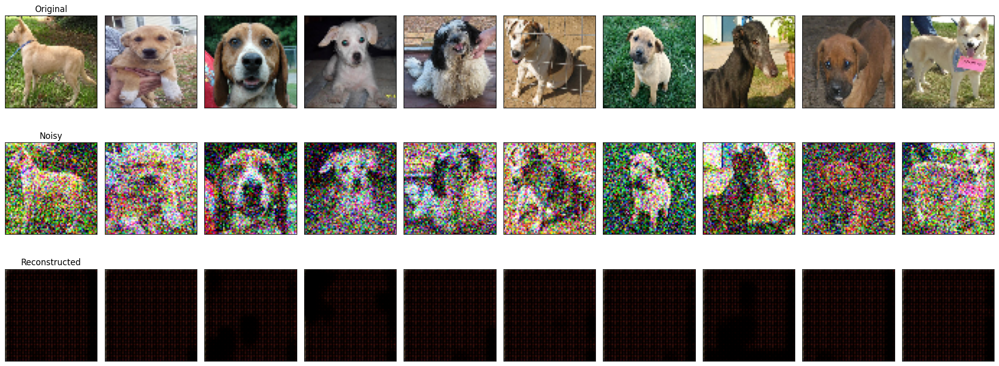

25/25 [==============================] - 86s 3s/step - loss: 0.0654 - val_loss: 0.2426 - lr: 0.0750
Epoch 2/100
25/25 [==============================] - 56s 2s/step - loss: 0.0268 - val_loss: 0.2106 - lr: 0.0750
Epoch 3/100
25/25 [==============================] - 53s 2s/step - loss: 0.0221 - val_loss: 0.0665 - lr: 0.0750
Epoch 4/100
25/25 [==============================] - 54s 2s/step - loss: 0.0203 - val_loss: 0.0409 - lr: 0.0750
Epoch 5/100
25/25 [==============================] - 61s 2s/step - loss: 0.0194 - val_loss: 0.0465 - lr: 0.0750
Epoch 6/100
25/25 [==============================] - 56s 2s/step - loss: 0.0187 - val_loss: 0.0425 - lr: 0.0750
Epoch 7/100
25/25 [==============================] - 54s 2s/step - loss: 0.0180 - val_loss: 0.0361 - lr: 0.0750
Epoch 8/100
25/25 [==============================] - 56s 2s/step - loss: 0.0177 - val_loss: 0.0301 - lr: 0.0750
Epoch 9/100
25/25 [==============================] - 54s 2s/step - loss: 0.0174 - val_loss: 0.0279 - lr: 0.0750
Epoc

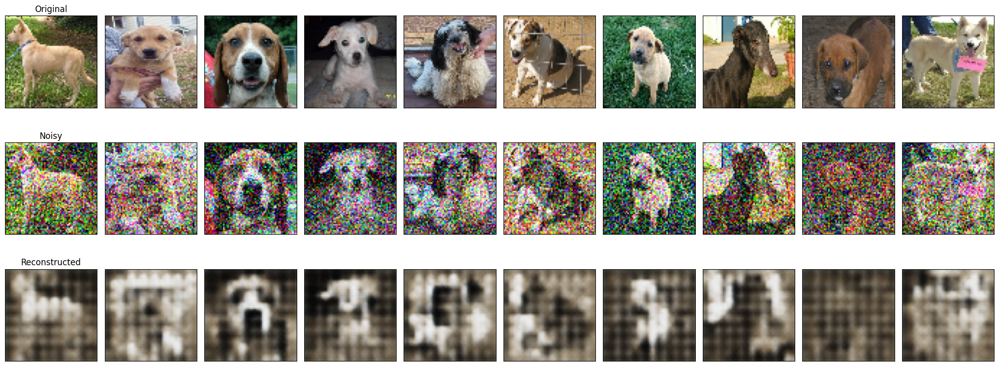

25/25 [==============================] - 59s 2s/step - loss: 0.0170 - val_loss: 0.0255 - lr: 0.0750
Epoch 12/100
25/25 [==============================] - 55s 2s/step - loss: 0.0167 - val_loss: 0.0299 - lr: 0.0750
Epoch 13/100
25/25 [==============================] - 57s 2s/step - loss: 0.0158 - val_loss: 0.0428 - lr: 0.0750
Epoch 14/100
25/25 [==============================] - 58s 2s/step - loss: 0.0150 - val_loss: 0.0497 - lr: 0.0750
Epoch 15/100
25/25 [==============================] - 56s 2s/step - loss: 0.0151 - val_loss: 0.0546 - lr: 0.0750
Epoch 16/100
25/25 [==============================] - 57s 2s/step - loss: 0.0149 - val_loss: 0.0445 - lr: 0.0750
Epoch 17/100
25/25 [==============================] - 57s 2s/step - loss: 0.0146 - val_loss: 0.0363 - lr: 0.0150
Epoch 18/100
25/25 [==============================] - 55s 2s/step - loss: 0.0143 - val_loss: 0.0291 - lr: 0.0150
Epoch 19/100
25/25 [==============================] - 57s 2s/step - loss: 0.0143 - val_loss: 0.0246 - lr: 0.0

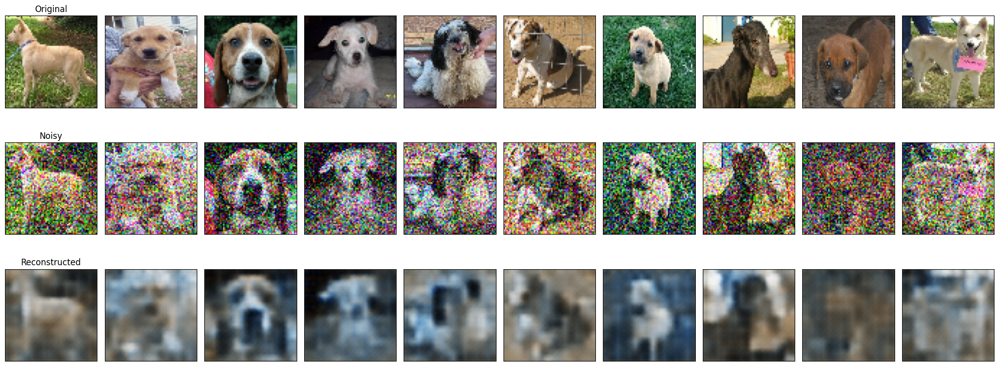

25/25 [==============================] - 60s 2s/step - loss: 0.0143 - val_loss: 0.0191 - lr: 0.0150
Epoch 22/100
25/25 [==============================] - 57s 2s/step - loss: 0.0142 - val_loss: 0.0174 - lr: 0.0150
Epoch 23/100
25/25 [==============================] - 58s 2s/step - loss: 0.0142 - val_loss: 0.0172 - lr: 0.0150
Epoch 24/100
25/25 [==============================] - 54s 2s/step - loss: 0.0141 - val_loss: 0.0167 - lr: 0.0150
Epoch 25/100
25/25 [==============================] - 55s 2s/step - loss: 0.0142 - val_loss: 0.0172 - lr: 0.0150
Epoch 26/100
25/25 [==============================] - 59s 2s/step - loss: 0.0141 - val_loss: 0.0155 - lr: 0.0150
Epoch 27/100
25/25 [==============================] - 57s 2s/step - loss: 0.0142 - val_loss: 0.0160 - lr: 0.0150
Epoch 28/100
25/25 [==============================] - 57s 2s/step - loss: 0.0142 - val_loss: 0.0154 - lr: 0.0150
Epoch 29/100
25/25 [==============================] - 58s 2s/step - loss: 0.0141 - val_loss: 0.0151 - lr: 0.0

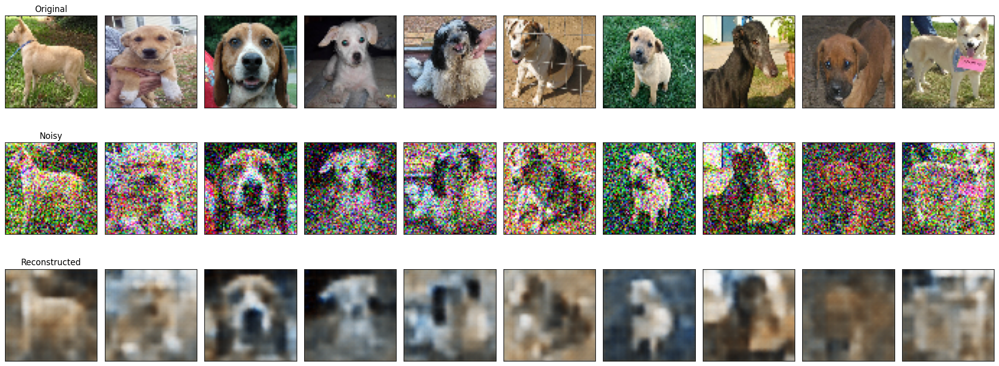

25/25 [==============================] - 60s 2s/step - loss: 0.0142 - val_loss: 0.0145 - lr: 0.0150
Epoch 32/100
25/25 [==============================] - 57s 2s/step - loss: 0.0141 - val_loss: 0.0155 - lr: 0.0150
Epoch 33/100
25/25 [==============================] - 57s 2s/step - loss: 0.0140 - val_loss: 0.0153 - lr: 0.0150
Epoch 34/100
25/25 [==============================] - 56s 2s/step - loss: 0.0140 - val_loss: 0.0150 - lr: 0.0150
Epoch 35/100
25/25 [==============================] - 57s 2s/step - loss: 0.0141 - val_loss: 0.0155 - lr: 0.0150
Epoch 36/100
25/25 [==============================] - 57s 2s/step - loss: 0.0141 - val_loss: 0.0147 - lr: 0.0150
Epoch 37/100
25/25 [==============================] - 57s 2s/step - loss: 0.0139 - val_loss: 0.0141 - lr: 0.0030
Epoch 38/100
25/25 [==============================] - 55s 2s/step - loss: 0.0138 - val_loss: 0.0142 - lr: 0.0030
Epoch 39/100
25/25 [==============================] - 57s 2s/step - loss: 0.0139 - val_loss: 0.0140 - lr: 0.0

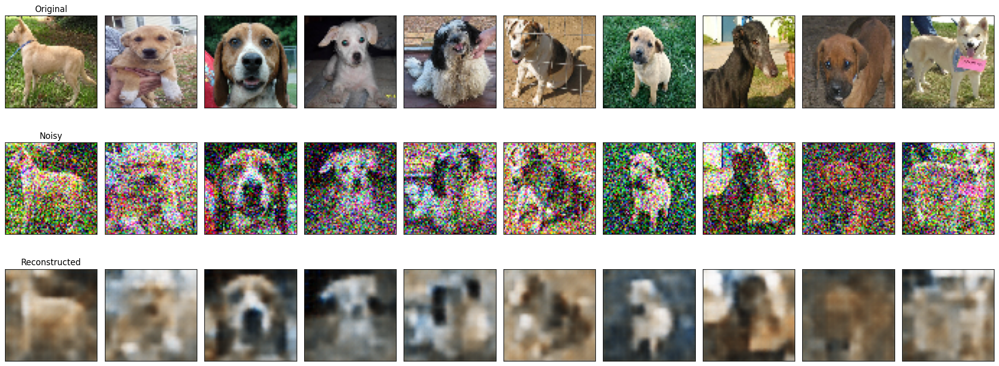

25/25 [==============================] - 61s 2s/step - loss: 0.0139 - val_loss: 0.0139 - lr: 0.0030
Epoch 42/100
25/25 [==============================] - 56s 2s/step - loss: 0.0139 - val_loss: 0.0137 - lr: 0.0030
Epoch 43/100
25/25 [==============================] - 59s 2s/step - loss: 0.0138 - val_loss: 0.0138 - lr: 0.0030
Epoch 44/100
25/25 [==============================] - 60s 2s/step - loss: 0.0138 - val_loss: 0.0137 - lr: 0.0030
Epoch 45/100
25/25 [==============================] - 59s 2s/step - loss: 0.0138 - val_loss: 0.0137 - lr: 0.0030
Epoch 46/100
25/25 [==============================] - 57s 2s/step - loss: 0.0138 - val_loss: 0.0136 - lr: 0.0030
Epoch 47/100
25/25 [==============================] - 56s 2s/step - loss: 0.0138 - val_loss: 0.0137 - lr: 0.0030
Epoch 48/100
25/25 [==============================] - 58s 2s/step - loss: 0.0138 - val_loss: 0.0136 - lr: 6.0000e-04
Epoch 49/100
25/25 [==============================] - 58s 2s/step - loss: 0.0138 - val_loss: 0.0136 - lr:

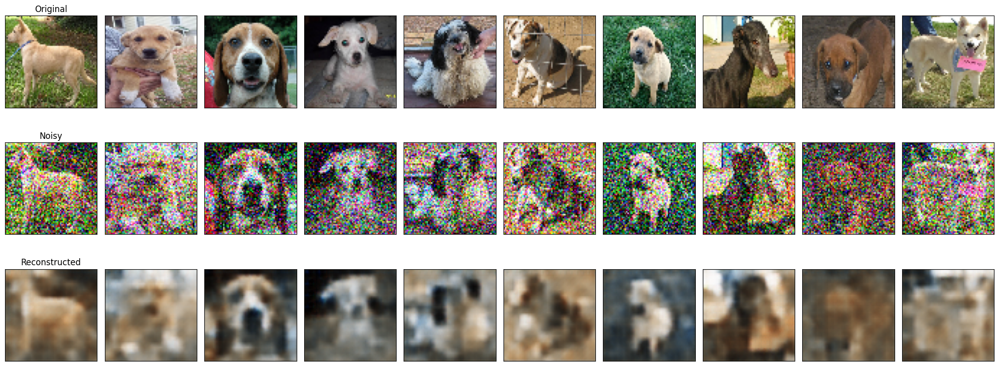

25/25 [==============================] - 60s 2s/step - loss: 0.0138 - val_loss: 0.0136 - lr: 6.0000e-04
Epoch 52/100
25/25 [==============================] - 58s 2s/step - loss: 0.0138 - val_loss: 0.0136 - lr: 6.0000e-04
Epoch 53/100
25/25 [==============================] - 58s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 6.0000e-04
Epoch 54/100
25/25 [==============================] - 58s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 1.2000e-04
Epoch 55/100
25/25 [==============================] - 57s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 1.2000e-04
Epoch 56/100
25/25 [==============================] - 60s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 1.2000e-04
Epoch 57/100
25/25 [==============================] - 61s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 1.2000e-04
Epoch 58/100
25/25 [==============================] - 60s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 1.2000e-04
Epoch 59/100
25/25 [==============================] - 65s 3s/step - loss: 0.0

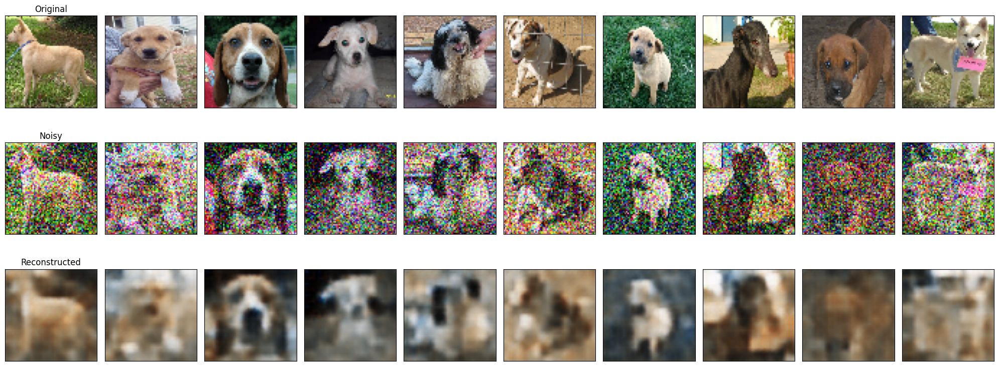

25/25 [==============================] - 59s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 2.4000e-05
Epoch 62/100
25/25 [==============================] - 59s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 2.4000e-05
Epoch 63/100
25/25 [==============================] - 55s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 2.4000e-05
Epoch 64/100
25/25 [==============================] - 57s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 4.8000e-06
Epoch 65/100
25/25 [==============================] - 61s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 4.8000e-06
Epoch 66/100
25/25 [==============================] - 61s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 4.8000e-06
Epoch 67/100
25/25 [==============================] - 61s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 4.8000e-06
Epoch 68/100
25/25 [==============================] - 59s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 4.8000e-06
Epoch 69/100
25/25 [==============================] - 57s 2s/step - loss: 0.0

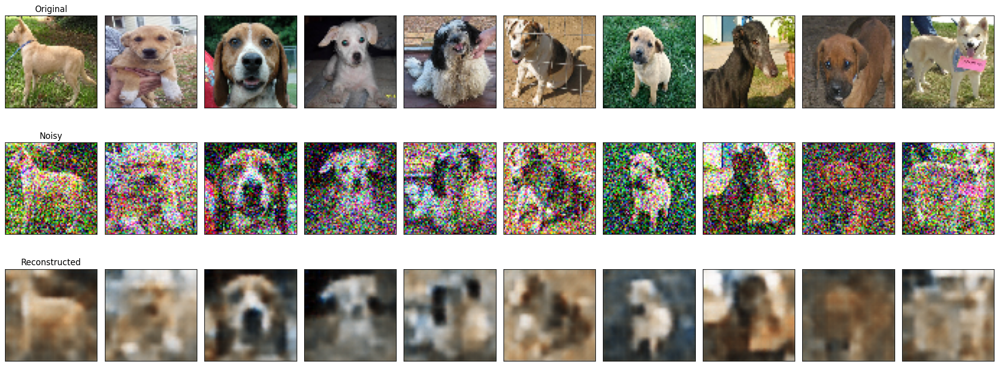

25/25 [==============================] - 59s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 9.6000e-07
Epoch 72/100
25/25 [==============================] - 59s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 9.6000e-07
Epoch 73/100
25/25 [==============================] - 57s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 9.6000e-07
Epoch 74/100
25/25 [==============================] - 56s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 1.9200e-07
Epoch 75/100
25/25 [==============================] - 58s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 1.9200e-07
Epoch 76/100
25/25 [==============================] - 57s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 1.9200e-07
Epoch 77/100
25/25 [==============================] - 53s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 1.9200e-07
Epoch 78/100
25/25 [==============================] - 56s 2s/step - loss: 0.0137 - val_loss: 0.0135 - lr: 1.9200e-07
Epoch 79/100
25/25 [==============================] - 57s 2s/step - loss: 0.0

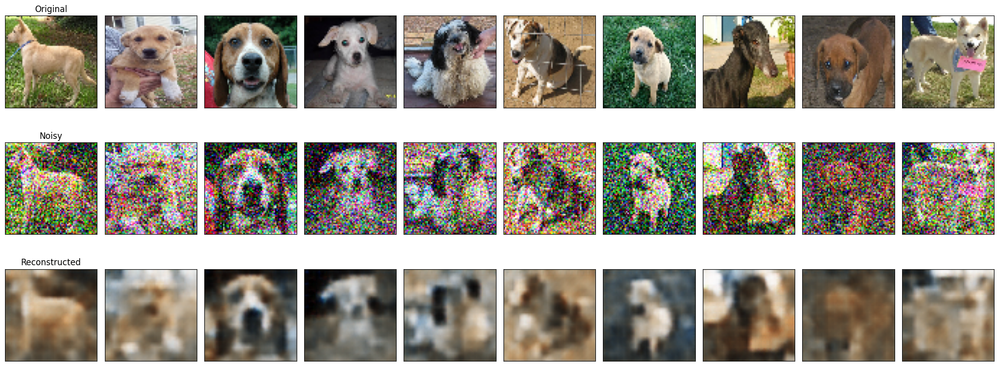

25/25 [==============================] - 59s 2s/step - loss: 0.0138 - val_loss: 0.0135 - lr: 3.8400e-08
Epoch 82/100
1/1 [==============================] - 0s 80ms/step


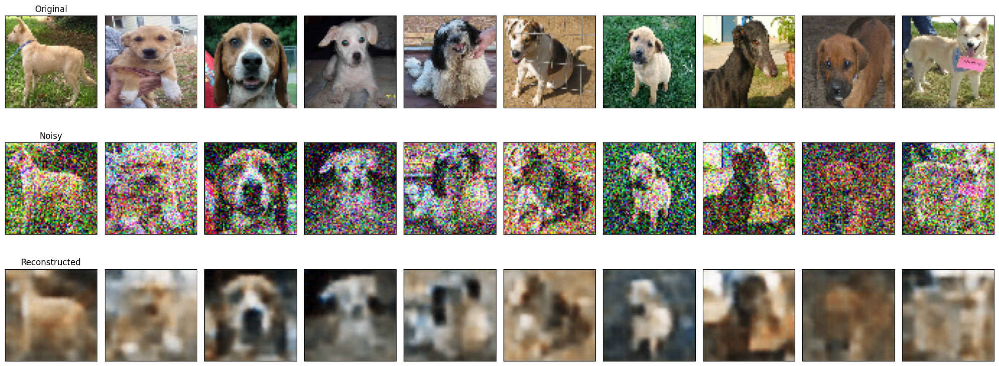

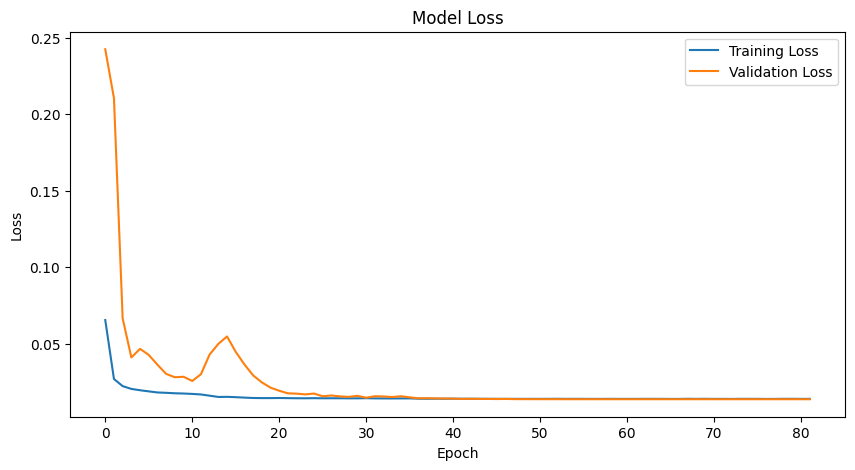

Training completed. Model saved as 'best_model.h5'


In [4]:
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
import os

# Mount Google Drive
drive.mount('/content/drive')

# Define hyperparameters
BATCH_SIZE = 128
EPOCHS = 100
LEARNING_RATE = 0.075
IMG_SIZE = 64

def build_autoencoder(input_shape, encoding_dim):
    inputs = layers.Input(shape=input_shape)

    # Encoder
    x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D((2, 2), padding='same')(x)
    x = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling2D((2, 2), padding='same')(x)
    x = layers.Conv2D(8, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    encoded = layers.MaxPooling2D((2, 2), padding='same')(x)

    # Decoder
    x = layers.Conv2DTranspose(8, (3, 3), strides=2, activation='relu', padding='same')(encoded)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2DTranspose(16, (3, 3), strides=2, activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2DTranspose(32, (3, 3), strides=2, activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    decoded = layers.Conv2D(input_shape[-1], (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = models.Model(inputs, decoded)
    return autoencoder

def plot_images(original, noisy, reconstructed, n=10):
    plt.figure(figsize=(20, 8))
    for i in range(n):
        # Original
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(original[i])
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if i == 0:
            ax.set_title("Original")

        # Noisy
        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(noisy[i])
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if i == 0:
            ax.set_title("Noisy")

        # Reconstructed
        ax = plt.subplot(3, n, i + 1 + 2*n)
        plt.imshow(reconstructed[i])
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if i == 0:
            ax.set_title("Reconstructed")

    plt.tight_layout()
    plt.savefig('reconstruction.png')
    plt.show()

def load_dataset(data_dir, noise_type, noise_factor):
    original_images = np.load(os.path.join(data_dir, 'original_images.npy'))
    noisy_images = np.load(os.path.join(data_dir, f'noisy_images_{noise_type}_{noise_factor}.npy'))
    return original_images, noisy_images

def main():
    # Load the dataset
    data_dir = '/content/drive/MyDrive/noisy_dataset'
    noise_type = 'gaussian'  # Choose from: 'gaussian', 'salt_and_pepper', 'poisson', 'speckle'
    noise_factor = 0.3  # Choose from: 0.1, 0.3, 0.5

    original_images, noisy_images = load_dataset(data_dir, noise_type, noise_factor)

    # Split data into train and test sets
    split = int(0.8 * len(original_images))
    x_train, x_test = original_images[:split], original_images[split:]
    x_train_noisy, x_test_noisy = noisy_images[:split], noisy_images[split:]

    # Create tf.data.Dataset
    train_dataset = tf.data.Dataset.from_tensor_slices((x_train_noisy, x_train))
    train_dataset = train_dataset.shuffle(buffer_size=1024).batch(BATCH_SIZE)

    test_dataset = tf.data.Dataset.from_tensor_slices((x_test_noisy, x_test))
    test_dataset = test_dataset.batch(BATCH_SIZE)

    # Build and compile the model
    autoencoder = build_autoencoder((IMG_SIZE, IMG_SIZE, 3), encoding_dim=8)
    autoencoder.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE),
                        loss='mse')

    # Callbacks
    early_stopping = callbacks.EarlyStopping(patience=10, restore_best_weights=True)
    reduce_lr = callbacks.ReduceLROnPlateau(factor=0.2, patience=5)
    model_checkpoint = callbacks.ModelCheckpoint('best_model.h5', save_best_only=True)

    # Custom callback for visualization
    class VisualizeReconstruction(callbacks.Callback):
        def on_epoch_end(self, epoch, logs=None):
            if epoch % 10 == 0:
                reconstructed = self.model.predict(x_test_noisy[:10])
                plot_images(x_test[:10], x_test_noisy[:10], reconstructed)

    # Train the model
    history = autoencoder.fit(
        train_dataset,
        epochs=EPOCHS,
        validation_data=test_dataset,
        callbacks=[early_stopping, reduce_lr, model_checkpoint, VisualizeReconstruction()]
    )

    # Evaluate and visualize results
    reconstructed = autoencoder.predict(x_test_noisy[:10])
    plot_images(x_test[:10], x_test_noisy[:10], reconstructed)

    # Plot training history
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    plt.savefig('training_history.png')
    plt.show()

    print("Training completed. Model saved as 'best_model.h5'")

if __name__ == "__main__":
    main()